In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import datetime
from dateutil.relativedelta import relativedelta
import random
from scipy.special import boxcox1p
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Lasso
from sklearn.linear_model import Ridge
from libraries.DataUtils import DataUtils

In [2]:
train = pd.read_csv("data//input//train.csv")
train.head(5)

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


In [3]:
test = pd.read_csv("data//input//test.csv")
test.head(5)

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition
0,1461,20,RH,80.0,11622,Pave,NaN,Reg,Lvl,AllPub,...,120,0,NaN,MnPrv,NaN,0,6,2010,WD,Normal
1,1462,20,RL,81.0,14267,Pave,NaN,IR1,Lvl,AllPub,...,0,0,NaN,NaN,Gar2,12500,6,2010,WD,Normal
2,1463,60,RL,74.0,13830,Pave,NaN,IR1,Lvl,AllPub,...,0,0,NaN,MnPrv,NaN,0,3,2010,WD,Normal
3,1464,60,RL,78.0,9978,Pave,NaN,IR1,Lvl,AllPub,...,0,0,NaN,NaN,NaN,0,6,2010,WD,Normal
4,1465,120,RL,43.0,5005,Pave,NaN,IR1,HLS,AllPub,...,144,0,NaN,NaN,NaN,0,1,2010,WD,Normal


In [4]:
"""
    Filter the columns and identifying their types:
    >Categorical columns are text based columns that don't have a specific order (e.g. Neighborhood representing the psysical location of the house)
    >Label columns are text/numeric based columns that have a specific order (e.g. OverallQual a numeric based columns that have values between 1 and 10)
    >Numeric columns, self explanatory, values that don't have specific order (e.g. LotArea representing lot size in square feet)
"""
categorical_columns = ['MSSubClass','MSZoning','Street','Alley','LotShape','LandContour',
                        'LotConfig','LandSlope','Neighborhood','Condition1','Condition2',
                        'BldgType','HouseStyle','RoofStyle','RoofMatl','Exterior1st','Exterior2nd',
                        'MasVnrType','Foundation','Heating','CentralAir','Electrical','Functional',
                        'GarageType','GarageFinish','PavedDrive','Fence','MiscFeature','SaleType',
                        'SaleCondition']

label_columns = ['Utilities','OverallQual','OverallCond','ExterQual','ExterCond','BsmtQual','BsmtExposure',
                'BsmtCond','BsmtFinType1','BsmtFinType2','HeatingQC','GarageQual','KitchenQual','FireplaceQu',
                'GarageCond','PoolQC']

numerical_columns = ['LotArea','YearBuilt','YearRemodAdd','MasVnrArea','BsmtFinSF1','BsmtFinSF2','BsmtUnfSF',
                        'TotalBsmtSF','1stFlrSF','2ndFlrSF','LowQualFinSF','GrLivArea','BsmtFullBath','BsmtHalfBath',
                        'FullBath','HalfBath','BedroomAbvGr','KitchenAbvGr','TotRmsAbvGrd','Fireplaces','GarageYrBlt',
                        'GarageCars','GarageArea','WoodDeckSF','OpenPorchSF','EnclosedPorch','3SsnPorch','ScreenPorch',
                        'PoolArea','MiscVal','MoSold','YrSold','LotFrontage']
#Verifying if all columns are here
#The test data set doesn't have SalePrice and also we don't take into consideration the Id column, 
# we are expecting n-1 columns
print(f'Total columns in data set {test.shape[1]}')
print(f'Total columns count: {len(categorical_columns)+len(label_columns)+len(numerical_columns)}')

Total columns in data set 80
Total columns count: 79


In [5]:
print(f'Number of rows {len(train)} - number of columns {len(train.columns)}\n')
print(train.columns,'\n')
DataUtils.columns_nan_description(train)

Number of rows 1460 - number of columns 81

Index(['Id', 'MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street',
       'Alley', 'LotShape', 'LandContour', 'Utilities', 'LotConfig',
       'LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType',
       'HouseStyle', 'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd',
       'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType',
       'MasVnrArea', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual',
       'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinSF1',
       'BsmtFinType2', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', 'Heating',
       'HeatingQC', 'CentralAir', 'Electrical', '1stFlrSF', '2ndFlrSF',
       'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath',
       'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual',
       'TotRmsAbvGrd', 'Functional', 'Fireplaces', 'FireplaceQu', 'GarageType',
       'GarageYrBlt', 'GarageFinish', 'GarageCars', 'GarageArea', 'G

In [6]:
print(f'Number of rows {len(test)} - number of columns {len(test.columns)}\n')
print(test.columns,'\n')
DataUtils.columns_nan_description(test)

Number of rows 1459 - number of columns 80

Index(['Id', 'MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street',
       'Alley', 'LotShape', 'LandContour', 'Utilities', 'LotConfig',
       'LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType',
       'HouseStyle', 'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd',
       'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType',
       'MasVnrArea', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual',
       'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinSF1',
       'BsmtFinType2', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', 'Heating',
       'HeatingQC', 'CentralAir', 'Electrical', '1stFlrSF', '2ndFlrSF',
       'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath',
       'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual',
       'TotRmsAbvGrd', 'Functional', 'Fireplaces', 'FireplaceQu', 'GarageType',
       'GarageYrBlt', 'GarageFinish', 'GarageCars', 'GarageArea', 'G

In [7]:
"""
    Looking for columns with high percentage of null values (50%)
    Putting "FireplaceQu" from train because it has almost 50% on train and over 50% on test.
"""
train_null_columns_ovr50 = ['Alley','MiscFeature','Fence','PoolQC','FireplaceQu']
test_null_columns_ovr50 = ['MiscFeature','Fence','PoolQC','FireplaceQu','Alley']

In [8]:
"""
    Looking for every high null percentage columns to see their description.
"""
for column in train_null_columns_ovr50:
    DataUtils.column_description(column)

Alley: Type of alley access to property



       Grvl	Gravel

       Pave	Paved

       NA 	No alley access

		

MiscFeature: Miscellaneous feature not covered in other categories

		

       Elev	Elevator

       Gar2	2nd Garage (if not described in garage section)

       Othr	Other

       Shed	Shed (over 100 SF)

       TenC	Tennis Court

       NA	None

		

Fence: Fence quality

		

       GdPrv	Good Privacy

       MnPrv	Minimum Privacy

       GdWo	Good Wood

       MnWw	Minimum Wood/Wire

       NA	No Fence

       NA	No Fence

	

PoolQC: Pool quality

		

       Ex	Excellent

       Gd	Good

       TA	Average/Typical

       Fa	Fair

       NA	No Pool

		

FireplaceQu: Fireplace quality



       Ex	Excellent - Exceptional Masonry Fireplace

       Gd	Good - Masonry Fireplace in main level

       TA	Average - Prefabricated Fireplace in main living area or Masonry Fireplace in basement

       Fa	Fair - Prefabricated Fireplace in basement

       Po	Poor - Ben Franklin Stove


In [9]:
"""
    As we can see from the description the null values doesn't not represent missing data, instead they represent the missing of the feature.
    Looking for the other columns with null values.
    As we can see from the from the description there are columns that instead of missing the feature they have null values.
"""
#Train columns
for column in train.columns[train.isnull().any()]:
    if column not in train_null_columns_ovr50:
        DataUtils.column_description(column)

LotFrontage: Linear feet of street connected to property



MasVnrType: Masonry veneer type



       BrkCmn	Brick Common

       BrkFace	Brick Face

       CBlock	Cinder Block

       None	None

       Stone	Stone

	

MasVnrArea: Masonry veneer area in square feet



BsmtQual: Evaluates the height of the basement



       Ex	Excellent (100+ inches)	

       Gd	Good (90-99 inches)

       TA	Typical (80-89 inches)

       Fa	Fair (70-79 inches)

       Po	Poor (<70 inches

       NA	No Basement

		

BsmtCond: Evaluates the general condition of the basement



       Ex	Excellent

       Gd	Good

       TA	Typical - slight dampness allowed

       Fa	Fair - dampness or some cracking or settling

       Po	Poor - Severe cracking, settling, or wetness

       NA	No Basement

	

BsmtExposure: Refers to walkout or garden level walls



       Gd	Good Exposure

       Av	Average Exposure (split levels or foyers typically score average or above)	

       Mn	Mimimum Exposure

       No	No Exp

In [10]:
#Test columns
for column in test.columns[test.isnull().any()]:
    if column not in test_null_columns_ovr50:
        DataUtils.column_description(column)

MSZoning: Identifies the general zoning classification of the sale.

		

       A	Agriculture

       C	Commercial

       FV	Floating Village Residential

       I	Industrial

       RH	Residential High Density

       RL	Residential Low Density

       RP	Residential Low Density Park 

       RM	Residential Medium Density

	

LotFrontage: Linear feet of street connected to property



Utilities: Type of utilities available

		

       AllPub	All public Utilities (E,G,W,& S)	

       AllPub	All public Utilities (E,G,W,& S)	

       NoSewr	Electricity, Gas, and Water (Septic Tank)

       NoSeWa	Electricity and Gas Only

       ELO	Electricity only	

	

Exterior1st: Exterior covering on house



       AsbShng	Asbestos Shingles

       AsphShn	Asphalt Shingles

       BrkComm	Brick Common

       BrkFace	Brick Face

       CBlock	Cinder Block

       CemntBd	Cement Board

       HdBoard	Hard Board

       ImStucc	Imitation Stucco

       MetalSd	Metal Siding

       Other	Other

      

In [11]:
"""
    After looking at the column description for both train and test data, we must identify those with missing feature for both train and test set.
"""
train_no_feature_columns = ['MasVnrType','BsmtQual','BsmtCond','BsmtExposure','BsmtFinType1','BsmtFinType2','GarageType','GarageFinish','GarageQual','GarageCond']
test_no_feature_columns = ['MasVnrType','BsmtQual','BsmtCond','BsmtExposure','BsmtFinType1','BsmtFinType2','GarageType','GarageFinish','GarageQual','GarageCond']

In [12]:
"""
    Changing the null values with "NA" for every column identified.
"""
for column in train_null_columns_ovr50:
    train[column].fillna("NA",inplace=True)
for column in test_null_columns_ovr50:
    test[column].fillna("NA",inplace=True)
for column in train_no_feature_columns:
    train[column].fillna("NA",inplace=True)
for column in test_no_feature_columns:
    test[column].fillna("NA",inplace=True)

In [13]:
"""
    Seeing the results for train and test
"""
print('Train:\n')
DataUtils.columns_nan_description(train)
print('Test:\n')
DataUtils.columns_nan_description(test)

Train:

There are 81 columns and 4 (4.94%) of them have null values.
LotFrontage - 259 values are null - 17.74%
MasVnrArea - 8 values are null - 0.55%
Electrical - 1 values are null - 0.07%
GarageYrBlt - 81 values are null - 5.55%
Test:

There are 80 columns and 18 (22.50%) of them have null values.
MSZoning - 4 values are null - 0.27%
LotFrontage - 227 values are null - 15.56%
Utilities - 2 values are null - 0.14%
Exterior1st - 1 values are null - 0.07%
Exterior2nd - 1 values are null - 0.07%
MasVnrArea - 15 values are null - 1.03%
BsmtFinSF1 - 1 values are null - 0.07%
BsmtFinSF2 - 1 values are null - 0.07%
BsmtUnfSF - 1 values are null - 0.07%
TotalBsmtSF - 1 values are null - 0.07%
BsmtFullBath - 2 values are null - 0.14%
BsmtHalfBath - 2 values are null - 0.14%
KitchenQual - 1 values are null - 0.07%
Functional - 2 values are null - 0.14%
GarageYrBlt - 78 values are null - 5.35%
GarageCars - 1 values are null - 0.07%
GarageArea - 1 values are null - 0.07%
SaleType - 1 values are n

In [14]:
"""
    After replacing all the null values with 'NA' there is stil a problem with some columns that have 'None' instead of 'NA',
    so we must replace all 'None' in the set with 'NA'
"""
train = train.replace('None',"NA")
test = test.replace('None',"NA")

In [15]:
"""
    There are still 2 columns with significant percentage of null 'GarageYrBlt' and 'LotFrontage'
"""
#GarageYrBlt
"""
Replacing the year of construction with 0 if the house doesn't have a garage 
Also we assume that the garage was built in the same year with the house if it value is missing
"""
train['GarageYrBlt'][train['GarageType']=='NA'] = 0
train['GarageYrBlt'][train['GarageYrBlt'].isnull()] = train['YearBuilt'][train['GarageYrBlt'].isnull()]
test['GarageYrBlt'][test['GarageType']=='NA'] = 0
test['GarageYrBlt'][test['GarageYrBlt'].isnull()] = test['YearBuilt'][test['GarageYrBlt'].isnull()]

#MasVnrArea
"""
Replacing the MasVnrArea with 0 if the MasVnrType is NA
"""
train['MasVnrArea'][train['MasVnrType']=='NA'] = 0
test['MasVnrArea'][test['MasVnrType']=='NA'] = 0


#TotalBsmtSF
"""
Replacing the TotalBsmtSF with 0 if the BsmtQual is NA
"""
test['TotalBsmtSF'][test['BsmtQual']=='NA'] = 0

#GarageArea
test['GarageArea'][test['GarageArea'].isnull()]= int(test.loc[test['GarageType']=='Detchd',['GarageArea']].mean())

#GarageCars
"""
Replacing the GarageCars with 0 if the GarageQual is NA
"""
test['GarageCars'][test['GarageQual']=='NA'] = 0

#SaleType
"""
Replacing the SaleType with Oth if the SaleType is missing
"""
test['SaleType'][test['SaleType'].isnull()] = 'Oth'

#Functional
#Home functionality (Assume typical unless deductions are warranted)
test['Functional'][test['Functional'].isnull()] = 'Typ'

"""
KitchenQual
Based on OverallQual:
     Ex	Excellent = [10,9]
     Gd	Good = [8,7]
     TA	Typical/Average = [6,5]
     Fa	Fair = [4,3]
     Po	Poor = [2,1]
     
index 95, OverallQual = 5
"""
test['KitchenQual'][test['KitchenQual'].isnull()] = 'TA'

#BsmtHalfBath
"""
Replacing the BsmtHalfBath with 0 if the BsmtQual is NA
"""
test['BsmtHalfBath'][test['BsmtQual'] == 'NA'] = 0

#BsmtFullBath
"""
Replacing the BsmtHalfBath with 0 if the BsmtQual is NA
"""
test['BsmtFullBath'][test['BsmtQual'] == 'NA'] = 0

#BsmtUnfSF
"""
Replacing the BsmtUnfSF with 0 if the BsmtQual is NA
"""
test['BsmtUnfSF'][test['BsmtQual'] == 'NA'] = 0

#BsmtFinSF2
"""
Replacing the BsmtFinSF2 with 0 if the BsmtQual is NA
"""
test['BsmtFinSF2'][test['BsmtQual'] == 'NA'] = 0

#BsmtFinSF1
"""
Replacing the BsmtFinSF1 with 0 if the BsmtQual is NA
"""
test['BsmtFinSF1'][test['BsmtQual'] == 'NA'] = 0

#Exterior2nd
"""
Replacing the Exterior2nd with Oth if the Exterior2nd is missing
"""
test['Exterior2nd'][test['Exterior2nd'].isnull()] = 'Other'

#Exterior1st
"""
Replacing the Exterior1st with Oth if the Exterior1st is missing
"""
test['Exterior1st'][test['Exterior1st'].isnull()] = 'Other'

"""
Utilities
Based on OverallQual:
     AllPub	All public Utilities (E,G,W,& S) [10,9,8]
     NoSewr	Electricity, Gas, and Water (Septic Tank)[7,6,5]
     NoSeWa	Electricity and Gas Only[4,5]
     ELO	Electricity only[3,2,1]
index 455, OverallQual = 2
index 485, OverallQual = 6
"""
test['Utilities'][test['OverallQual']==6] = 'NoSewr'
test['Utilities'][test['OverallQual']==2] = 'ELO'

#Electrical: Electrical system
"""
Replacing the Electrical with Mixed if the Electrical is missing
"""
train['Electrical'][train['Electrical'].isnull()] = 'Mixed'

In [16]:
"""
    After the preparation of almost all columns with null values there is the problematic one, 'LotFrontage' with
    227 missing values on train, respectively 259 on test set.
    On train there are still 4 missing values on 'MSZoning'. For this we gonna use a weighted average.
    We can see that there are ~75% RL values and ~15% RM ones, so we gonna put 3 values of RL and 1 of RM randomly
"""
#MSZoning
print(train['MSZoning'].value_counts(normalize=True)*100)
list_of_input_data = ['RL','RL','RL','RM']
random.shuffle(list_of_input_data)
test['MSZoning'][test['MSZoning'].isnull()] = list_of_input_data

RL         78.835616
RM         14.931507
FV          4.452055
RH          1.095890
C (all)     0.684932
Name: MSZoning, dtype: float64


In [17]:
"""
    Seeing the results for train and test
"""
print('Train:\n')
DataUtils.columns_nan_description(train)
print('Test:\n')
DataUtils.columns_nan_description(test)

Train:

There are 81 columns and 1 (1.23%) of them have null values.
LotFrontage - 259 values are null - 17.74%
Test:

There are 80 columns and 1 (1.25%) of them have null values.
LotFrontage - 227 values are null - 15.56%


In [18]:
"""
    The last column with null values is LotFrontage (Linear feet of street connected to property)
    We can take the mean of the whole column, but we can do something better, apply the mean for every
    neighborhood.
"""
def mean_of_neighborhood(df,neighborhood):
    mean = df.loc[(df['Neighborhood']==neighborhood),'LotFrontage'].mean()
    return mean
train_lot_frontage_mean = {neighborhood:mean_of_neighborhood(train,neighborhood) for neighborhood in list(train['Neighborhood'].unique())}
test_lot_frontage_mean = {neighborhood:mean_of_neighborhood(test,neighborhood) for neighborhood in list(test['Neighborhood'].unique())}

train['LotFrontage'] = train['LotFrontage'].fillna(train['Neighborhood'].map(train_lot_frontage_mean))
test['LotFrontage'] = test['LotFrontage'].fillna(test['Neighborhood'].map(test_lot_frontage_mean))

In [19]:
"""
    Seeing the results for train and test
"""
print('Train:\n')
DataUtils.columns_nan_description(train)
print('Test:\n')
DataUtils.columns_nan_description(test)

Train:

There are 81 columns and 0 (0.00%) of them have null values.
Test:

There are 80 columns and 0 (0.00%) of them have null values.


In [20]:
"""
    Instead of YearBuilt, YearRemodAdd, GarageYrBlt we are gonna put here the number of years between
    the year of construction and the year when this house was bought.
"""
train['GarageYrBlt'] = train['GarageYrBlt'].astype(int)
train['HouseAge'] = train.apply(lambda row: DataUtils.years_between(datetime.datetime(row['YearBuilt'],1,1),
                                                                 datetime.datetime(row['YrSold'],1,1)) if row['YearBuilt'] != 0 else 0,axis=1)
train['RemodAddAge'] = train.apply(lambda row: DataUtils.years_between(datetime.datetime(row['YearRemodAdd'],1,1),
                                                                 datetime.datetime(row['YrSold'],1,1)) if row['YearRemodAdd'] != 0 else 0,axis=1)
train['GarageAge'] = train.apply(lambda row: DataUtils.years_between(datetime.datetime(row['GarageYrBlt'],1,1),
                                                                 datetime.datetime(row['YrSold'],1,1))if row['GarageYrBlt'] != 0 else 0,axis=1)
numerical_columns.extend(['HouseAge','RemodAddAge','GarageAge'])
excluded_numerical_columns = ['YrSold','MoSold','GarageYrBlt','YearRemodAdd','YearBuilt']
numerical_columns = [x for x in numerical_columns if x not in excluded_numerical_columns]
train[['HouseAge','RemodAddAge','GarageAge']]

,HouseAge,RemodAddAge,GarageAge
0,5,5,5
1,31,31,31
2,7,6,7
3,91,36,8
4,8,8,8
...,...,...,...
1455,8,7,8
1456,32,22,32
1457,69,4,69
1458,60,14,60


In [21]:
"""
    We do the same thing on test set
"""
test['GarageYrBlt'] = test['GarageYrBlt'].astype(int)
test['HouseAge'] = test.apply(lambda row: DataUtils.years_between(datetime.datetime(row['YearBuilt'],1,1),
                                                                 datetime.datetime(row['YrSold'],1,1)) if row['YearBuilt'] != 0 else 0,axis=1)
test['RemodAddAge'] = test.apply(lambda row: DataUtils.years_between(datetime.datetime(row['YearRemodAdd'],1,1),
                                                                 datetime.datetime(row['YrSold'],1,1)) if row['YearRemodAdd'] != 0 else 0,axis=1)
test['GarageAge'] = test.apply(lambda row: DataUtils.years_between(datetime.datetime(row['GarageYrBlt'],1,1),
                                                                 datetime.datetime(row['YrSold'],1,1))if row['GarageYrBlt'] != 0 else 0,axis=1)
test[['HouseAge','RemodAddAge','GarageAge']]

,HouseAge,RemodAddAge,GarageAge
0,49,49,49
1,52,52,52
2,13,12,13
3,12,12,12
4,18,18,18
...,...,...,...
1454,36,36,0
1455,36,36,36
1456,46,10,46
1457,14,14,0


In [22]:
"""
    Looking at the SalePrice column skewness and kurtosis to have an idea about its distribution.
    Skewness measures the symmetry of the distribution, or in this case the lack of it, a positive value indicates 
    that the data is right skewed.
    Kurtosis measurea how heavy or light tailed the distribution is, a positive indicates a high tailed kurtosis.
"""
print("Sale Price skeness: ",train['SalePrice'].skew())
print("Sale Price kurtosis: ",train['SalePrice'].kurtosis())

Sale Price skeness:  1.8828757597682129
Sale Price kurtosis:  6.536281860064529


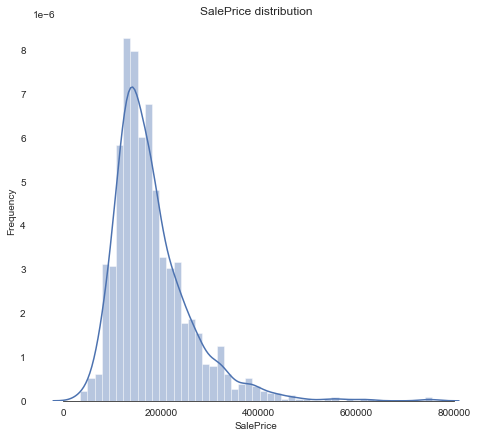

In [23]:
"""
    We can check if the values above are correct by ploting the histogram of the Sale Price column.
    As we can see there is a big tail in the right.
"""
sns.set_style("white")
sns.set_color_codes(palette='deep')
f, ax = plt.subplots(figsize=(8, 7))
#Check the new distribution 
sns.distplot(train['SalePrice'], color="b")
ax.xaxis.grid(False)
ax.set(ylabel="Frequency")
ax.set(xlabel="SalePrice")
ax.set(title="SalePrice distribution")
sns.despine(trim=True, left=True)
plt.show()

In [24]:
"""
    We can try to normalize this distribution, there are in general 2 methods that we can apply:
    1. Box-Cox transformation
    2. Log transformation
    But what I want to try first is to check for inflation, there is a huge posibility that the distribution
    is skewed due to the fact that newer house have an inflated price.
    Let's read the US Inflation Rates from 1929 to 2020 (source = https://www.thebalance.com/u-s-inflation-rate-history-by-year-and-forecast-3306093)
"""
us_inflation_rates = pd.read_csv("data//input//US_Inflation_Rates.csv")
print("US Inflation rates head:")
print(us_inflation_rates.head())
print("US Inflation rates tail:")
print(us_inflation_rates.tail())

US Inflation rates head:
   Year Inflation Rate YOY Fed Funds Rate*  \
0  1929              0.60%             NaN   
1  1930             -6.40%             NaN   
2  1931             -9.30%             NaN   
3  1932            -10.30%             NaN   
4  1933              0.80%             NaN   

          Business Cycle (GDP Growth) Events Affecting Inflation  
0                         August peak               Market crash  
1                 Contraction (-8.5%)               Smoot-Hawley  
2                 Contraction (-6.4%)                  Dust Bowl  
3                Contraction (-12.9%)           Hoover tax hikes  
4  Contraction ended in March (-1.2%)             FDR's New Deal  
US Inflation rates tail:
    Year Inflation Rate YOY Fed Funds Rate* Business Cycle (GDP Growth)  \
87  2016              2.10%           0.75%            Expansion (1.6%)   
88  2017              2.10%           1.50%            Expansion (2.4%)   
89  2018              1.90%           2.50%   

In [25]:
"""
    From this data set we only need the rate and we will use as an index the year to navigate more freely.
    Also we need to convert the percentage string (e.g. 2.1%) into a float number.
"""
us_inflation_rates = us_inflation_rates.set_index('Year')
us_inflation_rates = us_inflation_rates['Inflation Rate YOY'].apply(lambda x: float(x.strip('%'))/100)
us_inflation_rates.head()

Year
1929    0.006
1930   -0.064
1931   -0.093
1932   -0.103
1933    0.008
Name: Inflation Rate YOY, dtype: float64

In [26]:
"""
    We are gonna deflate the prices taking the YrSold as the nominal year and as the year we want to deflate to
    we need to find the minimum YrSold in the dataset, in this way we are gonna deflate to the same year (e.g. the minimum
    YrSold is 2008 we are gonna take the Real Price based on the year 2008)
"""
min_yr_sold = min(train['YrSold']) 
train['RealSalePrice'] = train.apply(lambda row: DataUtils.real_sale_price(us_inflation_rates,row['SalePrice'],min_yr_sold,row['YrSold']),axis=1)
print("Real Sale Price skeness: ",train['RealSalePrice'].skew())
print("Real Sale Price kurtosis: ",train['RealSalePrice'].kurtosis())

Real Sale Price skeness:  1.9051589456020446
Real Sale Price kurtosis:  6.792444414188774


In [27]:
"""
    Seeing the difference between the RealSalePrice and SalePrice kurtosis and skew.
"""
print("Sale Price skeness: ",train['SalePrice'].skew())
print("Sale Price kurtosis: ",train['SalePrice'].kurtosis())
print("Real Sale Price skeness: ",train['RealSalePrice'].skew())
print("Real Sale Price kurtosis: ",train['RealSalePrice'].kurtosis())

Sale Price skeness:  1.8828757597682129
Sale Price kurtosis:  6.536281860064529
Real Sale Price skeness:  1.9051589456020446
Real Sale Price kurtosis:  6.792444414188774


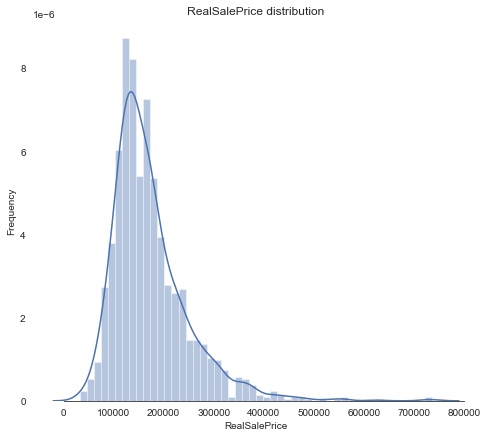

In [28]:
"""
    Plotting the real sale price distribution.
"""
sns.set_style("white")
sns.set_color_codes(palette='deep')
f, ax = plt.subplots(figsize=(8, 7))
#Check the new distribution 
sns.distplot(train['RealSalePrice'], color="b")
ax.xaxis.grid(False)
ax.set(ylabel="Frequency")
ax.set(xlabel="RealSalePrice")
ax.set(title="RealSalePrice distribution")
sns.despine(trim=True, left=True)
plt.show()

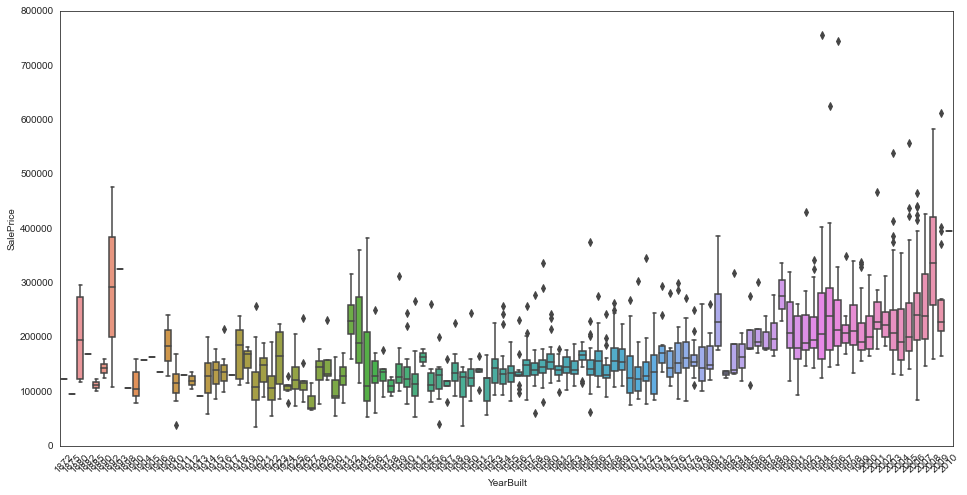

In [29]:
"""
    Let's check Sale Price over years.
"""
f, ax = plt.subplots(figsize=(16,8))
fig = sns.boxplot(x = train['YearBuilt'], y=train['SalePrice'])
fig.axis(ymin=0,ymax=800000)
plt.xticks(rotation=45);

In [30]:
"""
    Let's use the logarithmic function on the Sale Price and Real Sale Price column and see the skewness, kurtosis and distribution
    As we can see from the skew the distribution is almost symmetrical with a positive kurtosis, indicating a small heavy tail
"""
train['SalePriceLog1p'] = np.log1p(train['SalePrice'])
train['RealSalePriceLog1p'] = np.log1p(train['RealSalePrice'])
print("Log1p Sale Price skeness: ",train['SalePriceLog1p'].skew())
print("Log1p Sale Price kurtosis: ",train['SalePriceLog1p'].kurtosis())
print("Log1p Real Sale Price skeness: ",train['RealSalePriceLog1p'].skew())
print("Log1p Real Sale Price kurtosis: ",train['RealSalePriceLog1p'].kurtosis())

Log1p Sale Price skeness:  0.12134661989685333
Log1p Sale Price kurtosis:  0.809519155707878
Log1p Real Sale Price skeness:  0.11425170714747866
Log1p Real Sale Price kurtosis:  0.8169379082603396


[Text(0.5, 1.0, 'SalePriceLog1p vs RealSalePriceLog1p distribution')]

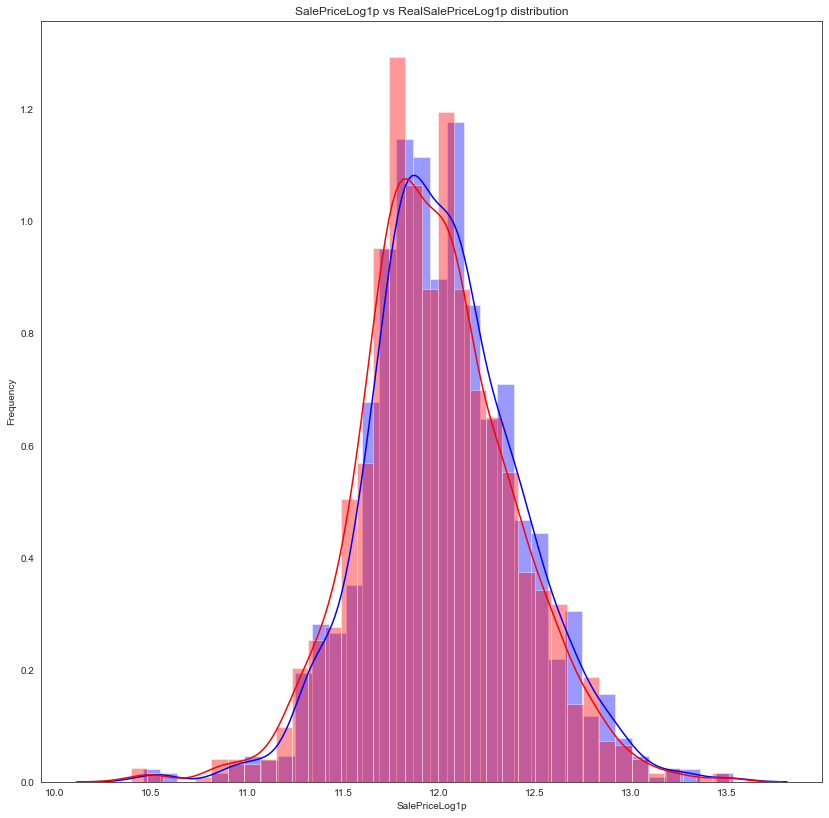

In [31]:
"""
    Plotting the difference between Real and Normal Sale Price after applying the logarithmic function.
"""
f, ax = plt.subplots(figsize=(14, 14))
#Check the new distribution 

#SalePrice
sns.distplot(train['SalePriceLog1p'], color="blue",ax=ax)
sns.distplot(train['RealSalePriceLog1p'], color="red",ax=ax)
ax.xaxis.grid(False)
ax.set(ylabel="Frequency")
ax.set(xlabel="SalePriceLog1p")
ax.set(title="SalePriceLog1p vs RealSalePriceLog1p distribution")

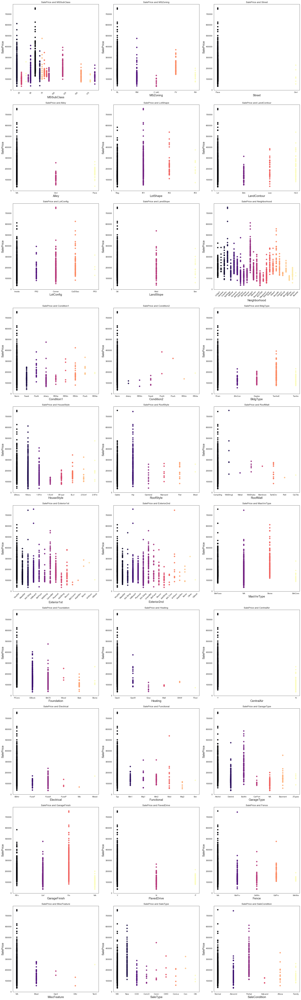

In [32]:
#Visualizing categorical data
num_plots = len(categorical_columns)
total_cols = 3
total_rows = num_plots//total_cols + (1 if num_plots % total_cols != 0 else 0)
fig, axs = plt.subplots(nrows=total_rows, ncols=total_cols,
                        figsize=(7*total_cols, 7*total_rows),constrained_layout=True)

for i, feature in enumerate(categorical_columns):
    row = i//total_cols
    pos = i % total_cols  

    cmaps = DataUtils.get_cmap(len(train[feature].unique()))
    colors_dict = {key:cmaps(i) for i,key in enumerate(list(train[feature].unique()))}
    
    axs[row][pos].scatter(x=feature,y='SalePrice',data=train,c=train[feature].map(colors_dict),alpha=0.90)

    axs[row][pos].set_xlabel(f'{feature}', fontsize=15)
    axs[row][pos].set_ylabel('SalePrice', fontsize=15)
    axs[row][pos].set_title(f'SalePrice and {feature}')
    if(len(train[feature].unique())>10):
        plt.setp(axs[row][pos].xaxis.get_majorticklabels(), rotation=45)

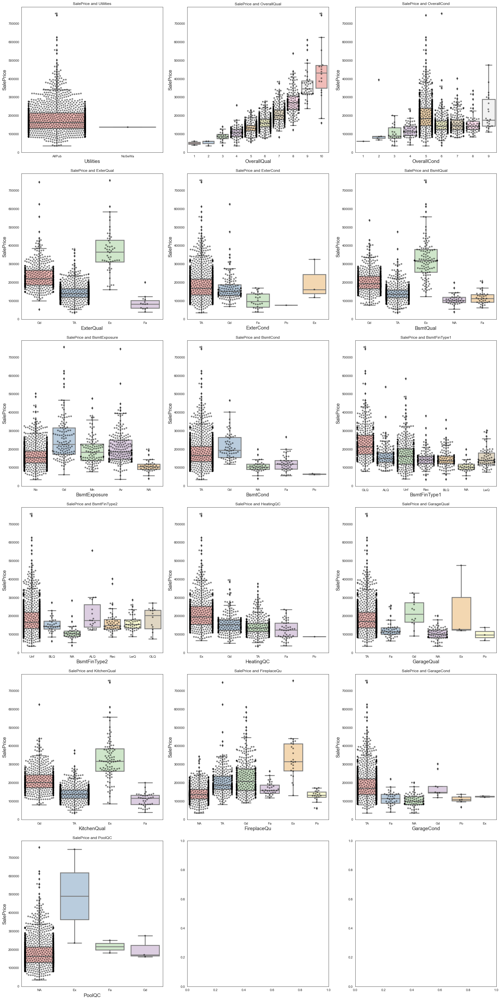

In [33]:
#Visualizing labeled data
num_plots = len(label_columns)
total_cols = 3
total_rows = num_plots//total_cols + (1 if num_plots % total_cols != 0 else 0)
fig, axs = plt.subplots(nrows=total_rows, ncols=total_cols,
                        figsize=(7*total_cols, 7*total_rows),constrained_layout=True)

for i, feature in enumerate(label_columns):
    row = i//total_cols
    pos = i % total_cols  

    sns.boxplot(x=feature,y='SalePrice',data=train,ax = axs[row][pos],palette="Pastel1",linewidth=2.5)
    sns.swarmplot(x=feature,y='SalePrice',data=train,ax = axs[row][pos],color = "black",alpha=0.5)

    axs[row][pos].set_xlabel(f'{feature}', fontsize=15)
    axs[row][pos].set_ylabel('SalePrice', fontsize=15)
    axs[row][pos].set_title(f'SalePrice and {feature}')

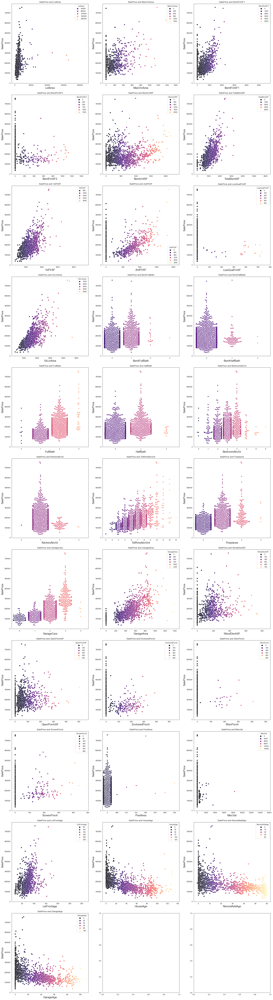

In [34]:
#Visualizing numeric data
num_plots = len(numerical_columns)
total_cols = 3
total_rows = num_plots//total_cols + (1 if num_plots % total_cols != 0 else 0)
fig, axs = plt.subplots(nrows=total_rows, ncols=total_cols,
                        figsize=(7*total_cols, 7*total_rows),constrained_layout=True)

for i, feature in enumerate(numerical_columns):
    row = i//total_cols
    pos = i % total_cols  

    if(len(train[feature].unique())>14):
        sns.scatterplot(x=feature,y='SalePrice',hue=feature,data=train,ax = axs[row][pos],palette='magma')
    else:
        sns.swarmplot(x=feature,y='SalePrice',data=train,ax = axs[row][pos],palette='magma')

    axs[row][pos].set_xlabel(f'{feature}', fontsize=15)
    axs[row][pos].set_ylabel('SalePrice', fontsize=15)
    axs[row][pos].set_title(f'SalePrice and {feature}')

<AxesSubplot:xlabel='TotalBsmtSF', ylabel='SalePrice'>

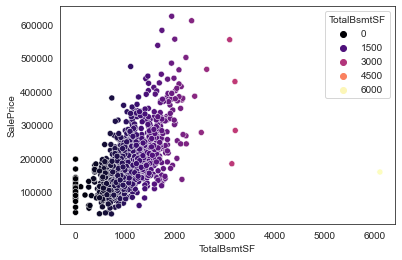

In [35]:
"""
    Now that we saw all the data, we have 2 outliers to remove.
    We can clearly see that in all plots there are 2 sale prices to high to be normal
    in any scenario so we have to remove them without even thinking to much about them.

    Let's look at the plot and see the effect.
"""
train.drop(train.loc[train['SalePrice']>700000].index,axis=0,inplace=True)
sns.scatterplot(x='TotalBsmtSF',y='SalePrice',hue='TotalBsmtSF',data=train,palette='magma')

In [36]:
"""
    As we checked the skewness of the SalePrice we will check the skewness of the other columns and try to apply
    the Box-Cox transformation.
"""
#On train
numerical_columns_skewness_train = train[numerical_columns].skew().sort_values(ascending=False)
#On test
numerical_columns_skewness_test = test[numerical_columns].skew().sort_values(ascending=False)
print('Skewness on train numerical columns')
print(numerical_columns_skewness_train.head())
print('Skewness on test numerical columns')
print(numerical_columns_skewness_test.head())

Skewness on train numerical columns
MiscVal         24.460085
PoolArea        16.084467
LotArea         12.220265
3SsnPorch       10.297106
LowQualFinSF     9.004955
dtype: float64
Skewness on test numerical columns
PoolArea         20.196888
MiscVal          20.075188
LowQualFinSF     16.167254
3SsnPorch        12.524216
EnclosedPorch     4.669172
dtype: float64


In [37]:
lam = 0.15
#BoxCox on train numerical columns
for col in numerical_columns_skewness_train.index:
    if abs(numerical_columns_skewness_train[col]) > 0.75:
        train[col] = boxcox1p(train[col],lam)

#BoxCox on test numerical columns
for col in numerical_columns_skewness_test.index:
    if abs(numerical_columns_skewness_test[col]) > 0.75:
        test[col] = boxcox1p(test[col],lam)   

In [38]:
#On train
numerical_columns_skewness_train = train[numerical_columns].skew().sort_values(ascending=False)
#On test
numerical_columns_skewness_test = test[numerical_columns].skew().sort_values(ascending=False)
print('Skewness on train numerical columns')
print(numerical_columns_skewness_train.head())
print('Skewness on test numerical columns')
print(numerical_columns_skewness_test.head())

Skewness on train numerical columns
PoolArea        15.539762
3SsnPorch        7.830261
LowQualFinSF     7.595647
MiscVal          5.507061
KitchenAbvGr     3.996633
dtype: float64
Skewness on test numerical columns
PoolArea        15.961132
3SsnPorch       10.629622
LowQualFinSF    10.593524
MiscVal          5.671882
BsmtHalfBath     3.650055
dtype: float64


In [39]:
DataUtils.columns_nan_description(train)
DataUtils.columns_nan_description(test)

There are 87 columns and 0 (0.00%) of them have null values.
There are 83 columns and 0 (0.00%) of them have null values.


In [40]:
train.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,YrSold,SaleType,SaleCondition,SalePrice,HouseAge,RemodAddAge,GarageAge,RealSalePrice,SalePriceLog1p,RealSalePriceLog1p
0,1,60,RL,5.831328,19.212182,Pave,NA,Reg,Lvl,AllPub,...,2008,WD,Normal,208500,5,5,5,195403.106769,12.247699,12.182825
1,2,20,RL,6.221214,19.712205,Pave,NA,Reg,Lvl,AllPub,...,2007,WD,Normal,181500,31,31,31,177073.170732,12.109016,12.084324
2,3,60,RL,5.914940,20.347241,Pave,NA,IR1,Lvl,AllPub,...,2008,WD,Normal,223500,7,6,7,209460.884234,12.317171,12.252297
3,4,70,RL,5.684507,19.691553,Pave,NA,IR1,Lvl,AllPub,...,2006,WD,Abnorml,140000,91,36,8,140000.000000,11.849405,11.849405
4,5,60,RL,6.314735,21.325160,Pave,NA,IR1,Lvl,AllPub,...,2008,WD,Normal,250000,8,8,8,234296.291090,12.429220,12.364346


In [41]:
test.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,HouseAge,RemodAddAge,GarageAge
0,1461,20,RH,80.0,20.479373,Pave,NA,Reg,Lvl,AllPub,...,MnPrv,NA,0.000000,6,2010,WD,Normal,49,49,49
1,1462,20,RL,81.0,21.327220,Pave,NA,IR1,Lvl,NoSewr,...,NA,Gar2,20.777526,6,2010,WD,Normal,52,52,52
2,1463,60,RL,74.0,21.196905,Pave,NA,IR1,Lvl,AllPub,...,MnPrv,NA,0.000000,3,2010,WD,Normal,13,12,13
3,1464,60,RL,78.0,19.865444,Pave,NA,IR1,Lvl,NoSewr,...,NA,NA,0.000000,6,2010,WD,Normal,12,12,12
4,1465,120,RL,43.0,17.257255,Pave,NA,IR1,HLS,AllPub,...,NA,NA,0.000000,1,2010,WD,Normal,18,18,18


In [42]:
train.to_csv("./data/input/train_cleaned.csv",index=False)
test.to_csv("./data/input/test_cleaned.csv",index=False)